### Importación de librerías útiles

In [48]:
import pandas as pd
import plotly.express as px

### Importamos el csv que necesitamos

In [46]:
data = pd.read_csv('funcionarios_2022_2.csv', sep=',', encoding='latin1', low_memory=False)

### ¿Qué contiene el dataframe?

In [ ]:
data.head(4)

,anho,mes,nivel,descripcion_nivel,entidad,descripcion_entidad,oee,descripcion_oee,documento,nombres,...,devengado,movimiento,lugar,fecha_nacimiento,fec_ult_modif,uri,fecha_acto,correo,profesion,motivo_movimiento
0,2022,2,30,MUNICIPALIDADES,12,DEPARTAMENTO DE ÑEEMBUCU,196,MUNICIPALIDAD DE HUMAITA,0777825,JUAN,...,150000,NaN,NaN,1956/06/16 00:00:00.000,2022/03/12 11:33:02.551000000,http://datos.sfp.gov.py/id/funcionarios/0777825,2021/12/18 00:00:00.000,humaita@municipalidadhumaita.gov.py,SERVIDOR PUBLICO,NaN
1,2022,2,30,MUNICIPALIDADES,12,DEPARTAMENTO DE ÑEEMBUCU,196,MUNICIPALIDAD DE HUMAITA,0777825,JUAN,...,300000,NaN,NaN,1956/06/16 00:00:00.000,2022/03/12 11:33:02.563000000,http://datos.sfp.gov.py/id/funcionarios/0777825,2021/12/19 00:00:00.000,humaita@municipalidadhumaita.gov.py,SERVIDOR PUBLICO,NaN
2,2022,2,40,SOCIEDADES ANONIMAS CON PARTICIPACION ACCIONAR...,2,EMPRESA DE SERVICIOS SANITARIOS DEL PARAGUAY S.A.,1,EMPRESA DE SERVICIOS SANITARIOS DEL PARAGUAY S...,1000016,ODILON,...,3079000,A - ALTA (INCORPORACIÓN),0,1963/01/01 00:00:00.000,2022/03/08 10:05:18.119000000,http://datos.sfp.gov.py/id/funcionarios/1000016,2013/07/01 00:00:00.000,salarios.essap@hotmail.com,BACHILLER HUMANISTICO,Acta: 612/2013
3,2022,2,40,SOCIEDADES ANONIMAS CON PARTICIPACION ACCIONAR...,2,EMPRESA DE SERVICIOS SANITARIOS DEL PARAGUAY S.A.,1,EMPRESA DE SERVICIOS SANITARIOS DEL PARAGUAY S...,1000016,ODILON,...,615808,A - ALTA (INCORPORACIÓN),0,1963/01/01 00:00:00.000,2022/03/08 10:05:18.119000000,http://datos.sfp.gov.py/id/funcionarios/1000016,2013/07/01 00:00:00.000,salarios.essap@hotmail.com,BACHILLER HUMANISTICO,Acta: 612/2013


#### Veamos todas las columnas que posee

In [5]:
#columnas = list(data.columns.values)
#columnas
data.columns.values

array(['anho', 'mes', 'nivel', 'descripcion_nivel', 'entidad',
       'descripcion_entidad', 'oee', 'descripcion_oee', 'documento',
       'nombres', 'apellidos', 'funcion', 'estado', 'carga_horaria',
       'anho_ingreso', 'sexo', 'discapacidad', 'tipo_discapacidad',
       'fuente_financiamiento', 'objeto_gasto', 'concepto', 'linea',
       'categoria', 'cargo', 'presupuestado', 'devengado', 'movimiento',
       'lugar', 'fecha_nacimiento', 'fec_ult_modif', 'uri', 'fecha_acto',
       'correo', 'profesion', 'motivo_movimiento'], dtype=object)

#### Información adicional sobre las columnas

In [19]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 245918 entries, 0 to 245917
Data columns (total 35 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   anho                   245918 non-null  int64 
 1   mes                    245918 non-null  int64 
 2   nivel                  245918 non-null  int64 
 3   descripcion_nivel      245918 non-null  object
 4   entidad                245918 non-null  int64 
 5   descripcion_entidad    245918 non-null  object
 6   oee                    245918 non-null  int64 
 7   descripcion_oee        245918 non-null  object
 8   documento              245918 non-null  object
 9   nombres                245918 non-null  object
 10  apellidos              245918 non-null  object
 11  funcion                236305 non-null  object
 12  estado                 245918 non-null  object
 13  carga_horaria          219997 non-null  object
 14  anho_ingreso           245918 non-null  int64 
 15  

Aquí es posible observar que existen valores en columnas como "tipo_discapacidad" o "motivo_movimiento" que son completamente normales y no necesitan completarse. Veremos más adelante cómo trataremos estos registros.

#### Veamos si existen filas duplicadas

In [ ]:
data.duplicated()

0         False
1         False
2         False
3         False
4         False
          ...  
245913    False
245914    False
245915    False
245916    False
245917    False
Length: 245918, dtype: bool

#### Analizaremos la cantidad de funcionarios por cada institución.

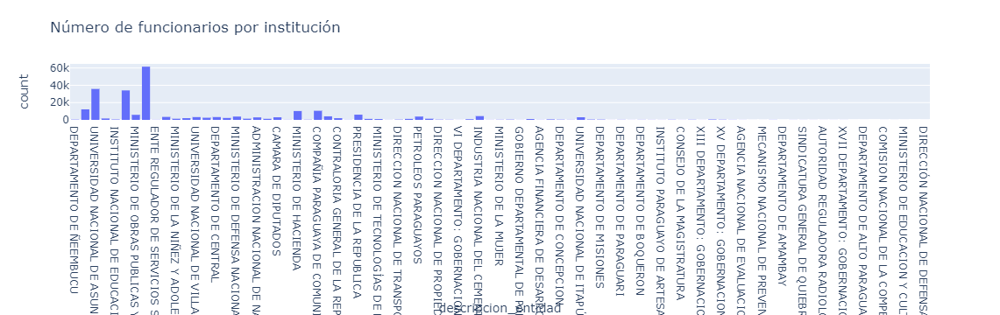

In [61]:
fig = px.histogram(data, x="descripcion_entidad", title='Número de funcionarios por institución')
fig.show()

#### Mismo gráfico pero con valores más representativos

#### Obtenemos el top20 de funcionarios por institución

In [76]:
data_aux = data[['descripcion_entidad']]
data_aux = data_aux.assign(cant_funcionarios=lambda x:1)
data_aux = data_aux.groupby(by='descripcion_entidad').count()
top20 = data_aux.nlargest(20, 'cant_funcionarios')
top20 = top20.reset_index()
top20

,descripcion_entidad,cant_funcionarios
0,INSTITUTO DE PREVISION SOCIAL,61495
1,UNIVERSIDAD NACIONAL DE ASUNCIÓN,35757
2,ADMINISTRACION NACIONAL DE ELECTRICIDAD,34059
3,EMPRESA DE SERVICIOS SANITARIOS DEL PARAGUAY S.A.,12166
4,COMPAÑIA PARAGUAYA DE COMUNICACIONES S.A.,10491
5,MINISTERIO DE HACIENDA,10211
6,PRESIDENCIA DE LA REPUBLICA,6015
7,MINISTERIO DE OBRAS PUBLICAS Y COMUNICACIONES,5826
8,INDUSTRIA NACIONAL DEL CEMENTO,4355
9,DEPARTAMENTO DE ITAPUA,4094


#### Graficamos

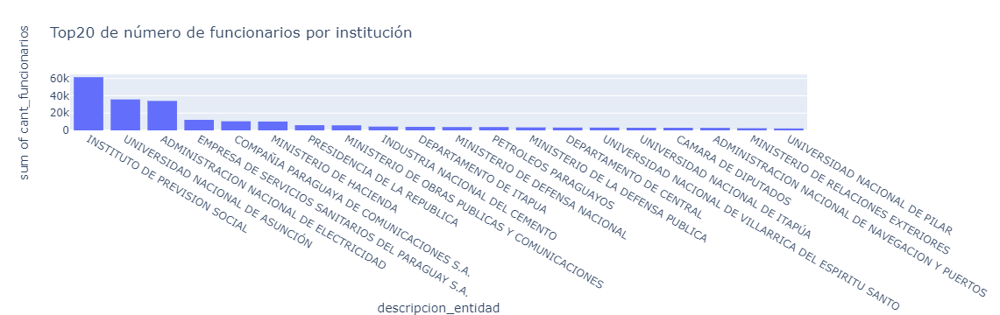

In [78]:
fig = px.histogram(top20, x="descripcion_entidad", y='cant_funcionarios',title='Top20 de número de funcionarios por institución')
fig.show()

#### Dividido por sexo

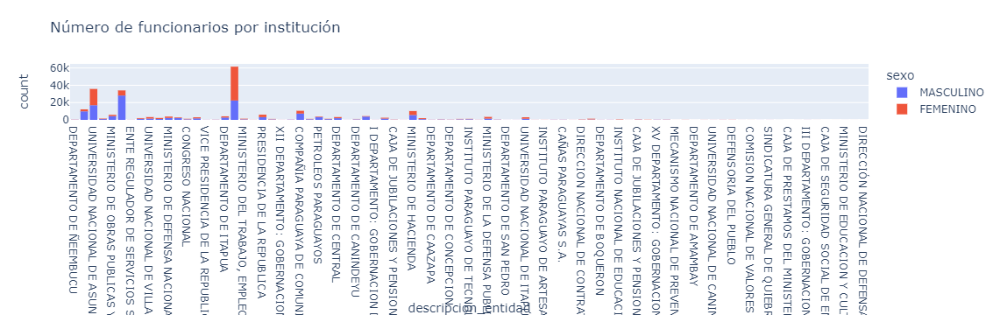

In [62]:
fig = px.histogram(data, x="descripcion_entidad", title='Número de funcionarios por institución', color='sexo')
fig.show()